<a href="https://colab.research.google.com/github/misqualzarabi/DS-Unit-2-Applied-Modeling/blob/master/Wrangle_dataset_Assignment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Lambda School Data Science

*Unit 2, Sprint 3, Module 1*

---


# Define ML problems

You will use your portfolio project dataset for all assignments this sprint.

## Assignment

Complete these tasks for your project, and document your decisions.

- [ ] Choose your target. Which column in your tabular dataset will you predict?
- [ ] Is your problem regression or classification?
- [ ] How is your target distributed?
    - Classification: How many classes? Are the classes imbalanced?
    - Regression: Is the target right-skewed? If so, you may want to log transform the target.
- [ ] Choose your evaluation metric(s).
    - Classification: Is your majority class frequency >= 50% and < 70% ? If so, you can just use accuracy if you want. Outside that range, accuracy could be misleading. What evaluation metric will you choose, in addition to or instead of accuracy?
    - Regression: Will you use mean absolute error, root mean squared error, R^2, or other regression metrics?
- [ ] Choose which observations you will use to train, validate, and test your model.
    - Are some observations outliers? Will you exclude them?
    - Will you do a random split or a time-based split?
- [ ] Begin to clean and explore your data.
- [ ] Begin to choose which features, if any, to exclude. Would some features "leak" future information?

If you haven't found a dataset yet, do that today. [Review requirements for your portfolio project](https://lambdaschool.github.io/ds/unit2) and choose your dataset.

Some students worry, ***what if my model isn't “good”?*** Then, [produce a detailed tribute to your wrongness. That is science!](https://twitter.com/nathanwpyle/status/1176860147223867393)

In [12]:
from google.colab import files
uploaded = files.upload()

Saving hotel-booking-demand.zip to hotel-booking-demand (1).zip


In [0]:
import pandas as pd


In [14]:
df = pd.read_csv("/content/hotel-booking-demand.zip")
print(df.shape)
df.head()

(119390, 32)


,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,3,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,4,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,0.0,0,BB,GBR,Direct,Direct,0,0,0,A,C,0,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,0.0,0,BB,GBR,Corporate,Corporate,0,0,0,A,A,0,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,0.0,0,BB,GBR,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,2015-07-03


In [15]:
!pip install pandas-profiling==2.*
!pip install category_encoders==2.*


In [16]:
import pandas_profiling
df.profile_report()

# **Target:**

* I have chosen "is_canceled" column as a target variable. I am going to predict what are the chances the person is going to cancel reservation they made and what are the factors affecting one person's decision.
* It is a classification problem.

* Target variable is binary classified and looking at its baseline below it seems a balanced classification.





In [17]:
df['is_canceled'].value_counts(normalize=True)

0    0.629584
1    0.370416
Name: is_canceled, dtype: float64

In [0]:
import matplotlib.pyplot as plt
import seaborn as sns

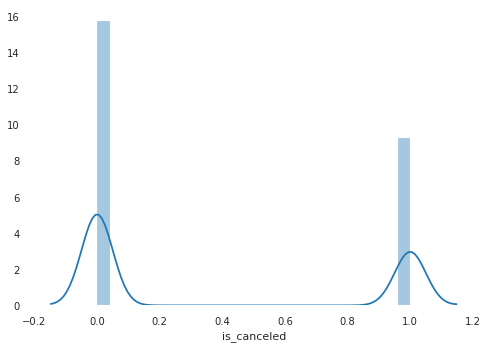

In [19]:
sns.distplot(df['is_canceled']);

## **Evaluation Metric:**


* The majority class frequency of y variable is > 50% and < 70% , so i will choose 'Accuracy' for the evaluation of my model.
# **Time based split:**


* I have the data available from 2015-2017, so instead of doing a random split i will try to do time based split.





In [20]:
# I will start data exploratory analysis by looking at all the other features
# if there are any column which will cause 'leakage' of information later
# while applying model;
# 'reservation_status' seems a duplicate column of a target variable, its 
# distribution is same and it does not provide any additional information
# It is better to drop this columnn

df['reservation_status'].value_counts(normalize=True)


Check-Out    0.629584
Canceled     0.360307
No-Show      0.010110
Name: reservation_status, dtype: float64

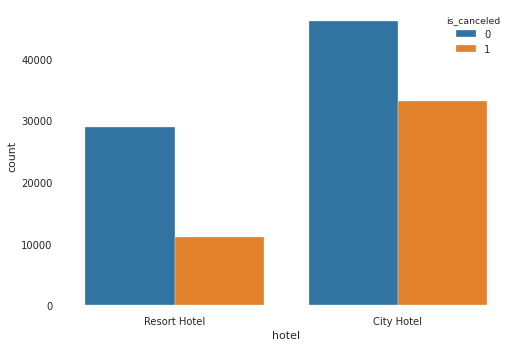

In [21]:
ax = sns.countplot(x="hotel", hue="is_canceled", data=df)

In [0]:
common_country_names = df.country.value_counts()[:10].index
common_countries = df[df.country.isin(common_country_names)]

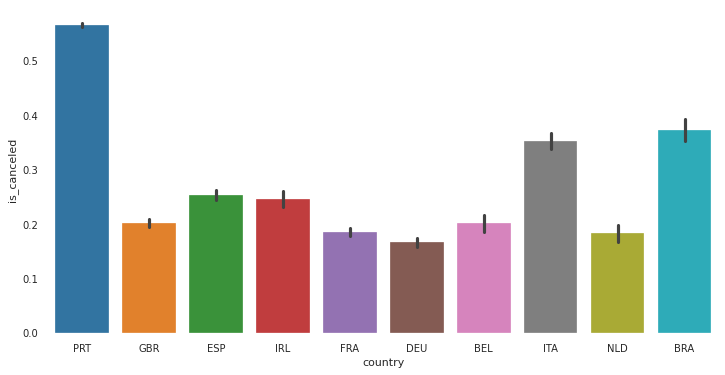

In [23]:
plt.figure(figsize=(12,6))
sns.barplot(x='country',y='is_canceled', data=common_countries);

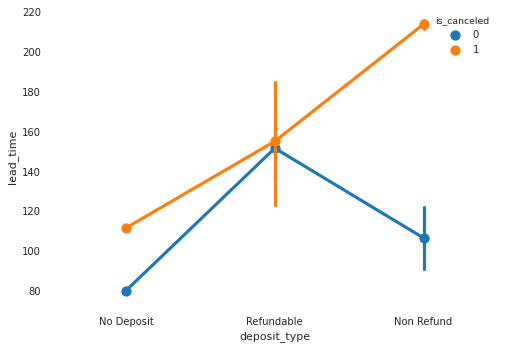

In [24]:
ax = sns.pointplot(x="deposit_type", y="lead_time",hue="is_canceled",data=df)

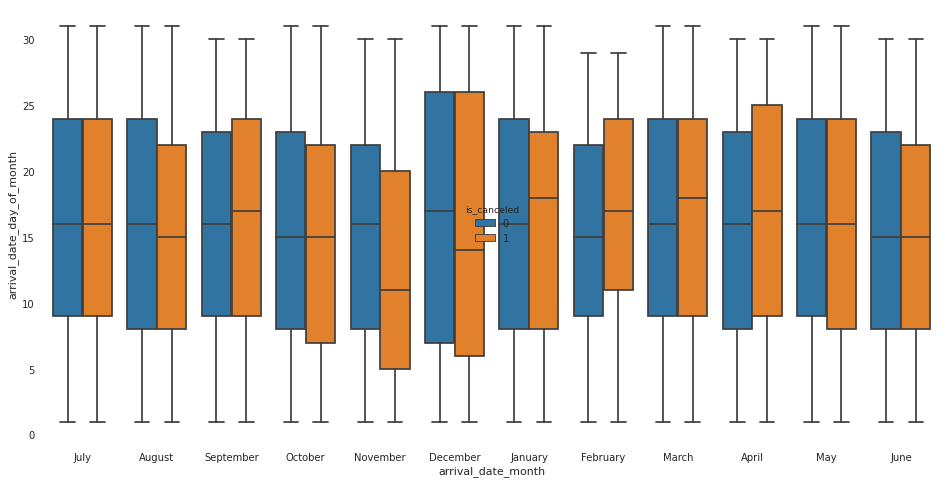

In [25]:
plt.figure(figsize=(16,8))
sns.boxplot(x="arrival_date_month", y="arrival_date_day_of_month", hue="is_canceled", data=df)

Text(0.5, 1.0, 'Number of Children distribution')

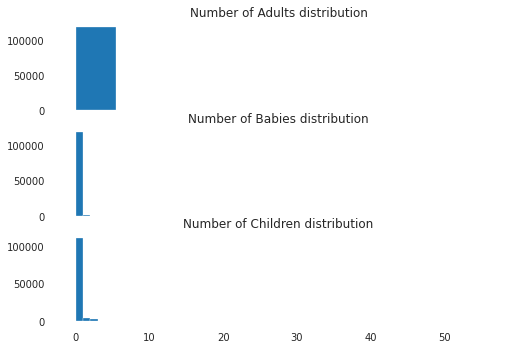

In [26]:
(fig, (ax1, ax2, ax3)) = plt.subplots(3,1, sharex=True)
ax1.hist(df['adults'], bins=10)
ax1.set_title('Number of Adults distribution')

ax2.hist(df['babies'], bins=10)
ax2.set_title('Number of Babies distribution')

ax3.hist(df['children'], bins=10)
ax3.set_title('Number of Children distribution')

In [27]:
# while looking at the 'Missing' values
# 'company' columns has 94% the data missed, 
# so we are going to drop this column

# observing the 'ZERO' values in data
#  'babies' is a skewed column; 99% of data shows there wasn't any babies so i have decided to drop this column as well

# I am gonna drop the rows of'adult' and 'children' column that have 'ZERO' values;

len(df[(df['adults']==0) & (df['children']==0)])

180

In [0]:
zero_guests = df[(df['adults']==0) & (df['children']==0)].index   
df.drop(zero_guests, inplace=True)

In [0]:
df.drop(columns=['company','reservation_status','babies'], inplace=True)

In [30]:
df.shape # checking the shape of the dataset now after cleaning the data

(119210, 29)

In [0]:
df['reservation_status_date'] = pd.to_datetime(df['reservation_status_date'])

In [32]:
df['arrival_date_year'].value_counts()

2016    56623
2017    40620
2015    21967
Name: arrival_date_year, dtype: int64

In [0]:
train = df[df['reservation_status_date'].dt.year <= 2015]
val = df[df['reservation_status_date'].dt.year == 2016]
test = df[df['reservation_status_date'].dt.year >= 2017]

In [34]:
train.shape, val.shape, test.shape

((25081, 29), (57715, 29), (36414, 29))

In [0]:
import category_encoders as ce
from sklearn.pipeline import make_pipeline
from sklearn.tree import DecisionTreeClassifier
from sklearn.impute import SimpleImputer

In [43]:
target = "is_canceled"
features = train.columns.drop([target, 'reservation_status_date'])
x_train = train[features]
y_train = train[target]
x_val = val[features]
y_val = val[target]

pipeline = make_pipeline(
    ce.OrdinalEncoder(),
    SimpleImputer(strategy='median'),
    DecisionTreeClassifier(max_depth=3)
)
pipeline.fit(x_train, y_train)
print(f'Val score (acc): {pipeline.score(x_val, y_val)}')

Val score (acc): 0.7312657021571515
